<a align="center">
    <img src='../Data/CT Medical Images/images/header_pic.jpg'>
</a>

# RSNA STR Pulmonary Embolism Detection - Kaggle Competition

**JPG Medical Image Exploratory Data Analysis**

#### Competition Goal:
To detect and classify PE cases using chest CTPA images.

#### The Data:
The original dataset is very large, around 1TB of CT DICOM data. Due to this, a Kaggle competetor, Ian Pan, has created a reduced size dataset with JPG images (256x256) to encourage more competetors (like myself). The data is organized into individual studies, with each study consisting of the images.

The images are saved in 3-channel RGB format, where each channel is a different ***window***. A *window* is created using a Radiologist technique called **windowing**, which is used to visualize CT scans. Values in a CT scan are called Hounsfield Units (HU), and tend to range from -1000 to 3000, where -1000 is air, and as the HU value increases, the denser the tissue is. To better visualize the different tissues in the scans, these *windows* are created by limiting what tissues are being focused in on. For example, lung tissues are roughly an HU value of -500 to -700, so a window of 1000 (width) is created with a center point (level) at -600. Therefore the *window* is set to range HU values from -1100 to -100.

For these specific images, the channels were created as follows:

- **RED / LUNG window / level=-600, width=1500**
- **GREEN / PULMONARY EMBOLISM window / level=100, width=700**
- **BLUE / MEDIASTINAL window / level=40, width=100**

#### The Prediction Labels:
Each study will have 9 study-level labels and 1 image-level label.

---

To get an idea of what tissues have which HU values, here is table for a rough representation:

### Table with HU values and correlating tissues:
<a>
    <img src='../Data/CT Medical Images/images/HU_table.png' align="left">
</a>

---

In [2]:
# Import neccessary packages for data wrangling
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import os
import sys
import glob
import cv2
from skimage import color
import functools
import torch
from torch.utils.data import TensorDataset, DataLoader,Dataset
from IPython.display import display
import IPython
# Python Imaging Library - PIL or pillow
from PIL import Image
# for writing GIF's
import imageio
# for making mesh
from skimage import measure, img_as_ubyte
from skimage.morphology import disk, opening, closing
from tqdm import tqdm
# for 3D regeneration
import k3d
import random
import matplotlib.colors as colors
from collections import OrderedDict

%matplotlib inline

# show all columns
pd.set_option('display.max_column', None)

In [3]:
## Check out the files/folders in the data folder

proj_path = '../Data/CT Medical Images/'
for file in os.listdir(proj_path):
    print(file)

dicom-example
images
train-jpegs
train.csv


In [4]:
df = pd.read_csv(proj_path + 'train.csv')
df.head()

,StudyInstanceUID,SeriesInstanceUID,SOPInstanceUID,pe_present_on_image,negative_exam_for_pe,qa_motion,qa_contrast,flow_artifact,rv_lv_ratio_gte_1,rv_lv_ratio_lt_1,leftsided_pe,chronic_pe,true_filling_defect_not_pe,rightsided_pe,acute_and_chronic_pe,central_pe,indeterminate
0,6897fa9de148,2bfbb7fd2e8b,c0f3cb036d06,0,0,0,0,0,0,1,1,0,0,1,0,0,0
1,6897fa9de148,2bfbb7fd2e8b,f57ffd3883b6,0,0,0,0,0,0,1,1,0,0,1,0,0,0
2,6897fa9de148,2bfbb7fd2e8b,41220fda34a3,0,0,0,0,0,0,1,1,0,0,1,0,0,0
3,6897fa9de148,2bfbb7fd2e8b,13b685b4b14f,0,0,0,0,0,0,1,1,0,0,1,0,0,0
4,6897fa9de148,2bfbb7fd2e8b,be0b7524ffb4,0,0,0,0,0,0,1,1,0,0,1,0,0,0


In [5]:
df.shape

(1790594, 17)

### Let's take a look at the feature descriptions

| Feature | Description |
| --- | --- |
| StudyInstanceUID | unique ID for each study (exam) in the data. |
|SeriesInstanceUID | unique ID for each series within the study. |
|SOPInstanceUID | unique ID for each image within the study (and data). |
|pe_present_on_image | image-level, notes whether any form of PE is present on the image.|
|negative_exam_for_pe | exam-level, whether there are any images in the study that have PE present.|
|qa_motion | informational, indicates whether radiologists noted an issue with motion in the study.|
|qa_contrast | informational, indicates whether radiologists noted an issue with contrast in the study.|
|flow_artifact | informational|
|rv_lv_ratio_gte_1 | exam-level, indicates whether the RV/LV ratio present in the study is >= 1|
|rv_lv_ratio_lt_1 | exam-level, indicates whether the RV/LV ratio present in the study is < 1|
|leftsided_pe | exam-level, indicates that there is PE present on the left side of the images in the study|
|chronic_pe | exam-level, indicates that the PE in the study is chronic|
|true_filling_defect_not_pe | informational, indicates a defect that is NOT PE|
|rightsided_pe | exam-level, indicates that there is PE present on the right side of the images in the study|
|acute_and_chronic_pe | exam-level, indicates that the PE present in the study is both acute AND chronic|
|central_pe | exam-level, indicates that there is PE present in the center of the images in the study|
|indeterminate | exam-level, indicates that while the study is not negative for PE, an ultimate set of exam-level labels could not be created, due to QA issues|

---
## Utility Functions

In [38]:
def window(img, WL=50, WW=350):
    '''
    Used to create a window defined as a Radiologist technique for narrowing Hounsfield Unit values visible in a CT scan.
    '''
    
    upper, lower = WL+WW//2, WL-WW//2
    X = np.clip(img.copy(), lower, upper)
    return X

### -----------------

def pixel_array(scans, channel):
    '''
    Create 3D pixel array.
    
    Parameters
    ----------
    
    scans : list
        The list of returned file paths for each scan using glob.glob
    
    channel : int
        BGR channels for the JPG images. cv2 reads them in as BGR.
        Values: (0 ,1, 2) for (B, G, R) or (mediastinal, PE, lung)
    '''
    
    for i, pth in enumerate(scans):

        img = cv2.imread(pth)[:,:,channel]
        if i == 0:
            slices = img
        else:
            slices = np.dstack((slices, img))
    
    return slices

### -----------------

def transform_to_hu(scans, key='PE'):
    
    '''
    Converts the BGR array values from 'cv2.imread()' to Hounsfield Units. The 'window' and 'level' values in 'jpg_dict' are \
defined by the values used to convert these images from DICOM datasets to JPG files as described by Ian Pan here:
    
    https://www.kaggle.com/c/rsna-str-pulmonary-embolism-detection/discussion/182930
    
    Parameters:
    -----------
    
    scans : array-like object
        Array created from the image path using glob.glob()
        
    key : default = 'PE'
        The key name defined by dictionary 'jpg_dict' with names ('PE', 'lung', 'mediastinal')
        
    '''
    
    # create simple dictionary to show relationship to RGB channel in JPGs as defined by Ian Pan
    jpg_dict = {'lung':{'index':2, 'window':1500, 'level':-600},
               'PE':{'index':1, 'window':700, 'level':100},
               'mediastinal':{'index':0, 'window':400, 'level':40}
               }
    
    # pull values from the dictionary
    W = jpg_dict[key]['window']
    L = jpg_dict[key]['level']
    I = jpg_dict[key]['index']

    # create conversion formula based on the channels WINDOW values
    # remember that the window value 'W' is the range of the values
    min_val = L - W//2 # returns integer with //
    max_val = L + W//2

    ## SLOPE INTERCEPT FORM
    # the slope is Window range / rgb range
    slope = W/256
    # intercept is equivalent to the 'min_val' since our lowest rgb val is 0. The formulat y = mx + b solves to be our min_val
    intercept = min_val
    
    # pull the arrays
    for i, pth in enumerate(scans):
        
        img = cv2.imread(pth)[:,:,I]
        if i == 0:
            slices = img
        else:
            slices = np.dstack((slices, img))
    
    
    slices = (slices*slope + min_val).astype(np.int16)
#     where the values are less than air (-1000), we will change them to -1000
#     slices = np.where(slices < -1000, -1000, slices)
            
    return slices

### -----------------

def plot_arr_vals(slices, n_slices=5, bins=50):
    '''
    Simple distribution plot for a specified array.
    
    Parameters:
    -----------
    
    slices : 3D array-like object
    
    n_slices : integer, default=5
        Number of plots displayed
        
    bins : integer, default=50
        Number of bins to distribute values into
    '''
    
    fig = plt.figure(figsize=(12,6))
    for n in range(n_slices):
        image = slices[:,:,np.random.randint(0, slices.shape[2])].flatten()
        sns.distplot(image, bins=bins);
    
    plt.title(f"Value distributions for {n_slices} samples")
    plt.xlabel('Pixel Value')

### -----------------

def segment_mask(image, co_low=-300, co_high=None):
    
    '''
    Segment an image based on its pixel values. Used to grab specific features like lungs.
    
    Parameters
    ----------
    
    image : array-like object
        
    co_low : integer, default=-300
        Determines where the lower cutoff is for creating the binary mask. Value can be determined by looking at the plotted values.
        Default value is for identifying lungs with lung slices.
        
    co_high : integer, default=None
        Determines where the upper cutoff is for creating the binary mask. Value can be determined by looking at the plotted values.
    '''
    
    segmented = np.zeros(image.shape)
    
    if co_low == None:
        co_low = image.min()
    if co_high == None:
        co_high = image.max()
         
    for n in range(image.shape[2]):
        image_seg = (image[:,:,n] >= co_low) & (image[:,:,n] <= co_high)

        binary_image = np.array(image_seg, dtype=np.int8)+1

        labels = measure.label(binary_image)
        
# Lungs have values of 1, as well as air. Organic tissues and water-like tissues (HU value of around 0) have values of 2.
# Since we only want lung tissues, we want to eliminate the values of 2. We can set these values to 0 when we do.

        bg_lbl_1 = labels[0,0]
        bg_lbl_2 = labels[0,-1]
        bg_lbl_3 = labels[-1,0]
        bg_lbl_4 = labels[-1,-1]
        
# Now we can set all labeled regions of the binary image that correspond to these corner-labels to the "not-lung" value of 2.

        #Fill the air around the person
        binary_image[bg_lbl_1 == labels] = 2
        binary_image[bg_lbl_2 == labels] = 2
        binary_image[bg_lbl_3 == labels] = 2
        binary_image[bg_lbl_4 == labels] = 2

        #We have a lot of remaining small signals outside of the lungs that need to be removed. 
        #In our competition closing is superior to fill_lungs 
        selem = disk(4)
        binary_image = closing(binary_image, selem)

        # print(np.unique(binary_image),'\n')

        # make it binary 
        binary_image -= 1
        # invert it so that tissues are 1
        binary_image = 1-binary_image

        segmented[:,:,n] = binary_image.copy() * image[:,:,n]
    
    return segmented

### -----------------

def create_gif(slices, save_img=None, masked=False, alpha=0.6, co_low=175, co_high=None):
    '''
    Create a GIF object using OpenCV, imageio, and IPython.
    
    Parameters
    ----------
    
    sclices : array-like object, folder path to images
        Object to be converted to GIF. File paths are acceptable like the example below:
            f_path = '../data/folder_to_images/*.jpg'
            
    save_img : str object, default=None
        To save an image, provide a string name ending in '.gif'
        
    masked : boolean, default=False
        If True, object will be overlayed with a mask defined by attributes 'co_low' and 'co_high'.
        
    alpha : float between 0 to 1, default=0.6
        Value that represents the transparency of the mask object, 0 is none, 1 is full color.
        
    co_low : integer, default=175
        Determines where the lower cutoff is for creating the binary mask. Value can be determined by looking at the plotted values.
        
    co_high : integer, default=None
        Determines where the upper cutoff is for creating the binary mask. Value can be determined by looking at the plotted values.

    '''
    
    # create empty list for storing GIF images
    images = []
    
    if masked == False:
            
        if type(slices) == np.ndarray:
            images = [slices[:,:,n].astype('uint8') for n in range(0, slices.shape[2])]
        else:
            images = [cv2.imread(f)[:,:,2] for f in glob.glob(slices)]
    
    else:
        try:        
            seg_slices = segment_mask(slices, co_low=co_low, co_high=co_high)

            for n in range(slices.shape[2]):

                # get individual image assignments
                img = slices[:,:,n]
                c_img = seg_slices[:,:,n]

                # Construct a colour image to superimpose
                color_mask = np.dstack((c_img, c_img, c_img))
                # make the mask red
                color_mask = color_mask * [1,0,0]

                # Construct RGB version of grey-level image
                img_color = np.dstack((img, img, img))

                # Convert the input image and color mask to Hue Saturation Value (HSV)
                # colorspace
                img_hsv = color.rgb2hsv(img_color)
                color_mask_hsv = color.rgb2hsv(color_mask)

                # Replace the hue and saturation of the original image
                # with that of the color mask
                img_hsv[:,:,0] = color_mask_hsv[:,:,0]
                img_hsv[:,:,1] = color_mask_hsv[:,:,1] * alpha

                img_masked = color.hsv2rgb(img_hsv)

                images.append(img_as_ubyte(img_masked))
                
        except:
            e = sys.exc_info()
            return print(f'Cannot use masked parameter for object type {type(slices)} due to:\n{e[0]}\n{e[1]}')
    
    if save_img == None:
        imageio.mimsave('../Data/CT Medical Images/images/gifs/func_gif.gif', images, duration=0.1)
        return IPython.display.Image('../Data/CT Medical Images/images/gifs/func_gif.gif', width=350)
    
    else:
        imageio.mimsave(save_img, images, duration=0.1)
        return IPython.display.Image(save_img, width=350)

### -----------------

def create_mesh_slices(slices='None', top_n=None, HU_val=None, l_count=100):
    
    '''
    Create slices of images that will be used for meshes.
    Function flow: label creation --> dataframe creation --> add column for HU values relating to label --> \
create dictionary of slices.
    
    Parameters:
    -----------
    slices : array-like structure with int values, default = 'None'
        This will be the array that is created from the 'transform_to_hu' function
    
    top_n : int, optional, default = None
        Useful for analyzing an image set for first glance (top_n = 25). Used to limit the number of HU values to be found
        
    HU_val : int, optional, default = None
        Limits which rows will be considered for creating dictionary slices
        
    l_count : int, default = 1000
        limits the number of rows that are considered based on the 'count' column
    '''
    
    ## -------------------------------
    # CREATE DATAFRAME WITH LABEL DATA
    #
    
    global labels, unique_labels, ul_counts, df_label, df_w_hu
    
    if slices == 'None':
        print('No labels were created.')
    else:
        # play around with 'connectivity' value. 1 or 3...
        labels = measure.label(slices, connectivity=3)
    
    # create the unique label array with the counts returned
    unique_labels, ul_counts = np.unique(labels, return_counts=True)
    
    # create empty list for label values
    val_list = []
    
    df_label = pd.DataFrame({'label':unique_labels, 'count':ul_counts}
                       ).sort_values(by='count', ascending=False
                                    ).reset_index(drop=True)
    
    # display the head of the new dataframe
    print('Head of label dataframe.')
    display(df_label.head())
    
    # create counter for number of values being searched
    X = 1
    
    # assign new variables for arrays and dataframe to be used
    flat_labels = labels.flatten()
    flat_slices = slices.flatten()
    
    if top_n != None:
        df_top = df_label.head(top_n)
    else:
        df_top = df_label[df_label['count'] > l_count]
        top_n = len(df_top)
    
    print('\nStarting to find HU values...\n')
    for lab in df_top[df_top['count'] > l_count].label:
        for i, val in enumerate(flat_labels):
            if val == lab:
                if X % 10 == 0 or X == top_n:
                    print(f'({X} / {top_n}) values found...')
                val_list.append(flat_slices[i])
                X += 1
                break
                
    # create a new df for the HU values that were found...
    df_w_hu = df_label.head(top_n)
    df_w_hu['HU val'] = val_list
    
    if HU_val != None:
        df_w_hu = df_w_hu[df_w_hu['HU val'] >= HU_val].reset_index()    
       
    print('\nDone finding HU values...')
    
    ## ----------------------
    # CREATE SLICE DICTIONARY
    
    # generate array with min value of slices (air)
    # make an original array to reference to
    min_val = slices.flatten().min()
    orig_slices_flat = slices.flatten()
    mod_slices = np.ones(orig_slices_flat.shape) * min_val
    
    # create a dictionary to save results
    image_slices = {'original_mod':mod_slices}
    
    if HU_val == None:
        
        # show table with values so the user can create an input
        print('\nDataframe with HU values.')
        display(df_w_hu)
    
        # user input which index they want to view
        ind = int(input('Enter index value for analysis:'))
        
        # create flattened arrays and set a min_val to replace any value with 'air' values
        filt_arr = np.where(labels!=df_label.label[ind],0,labels)
        filt_arr_flat = filt_arr.flatten()
        flat_slices = slices.flatten()
        min_val = flat_slices.min()
        
        print('\nCreating image dictionary...')
        for i, val in enumerate(filt_arr_flat):

            if val == 0:
                # replace the value in the original df with the min val in the array (esentially air when it comes to plotting)
                flat_slices[i] = min_val
                mod_slices[i] = orig_slices_flat[i]
        
        image_slices[str(f'image_index_{ind}')] = flat_slices.reshape(slices.shape)
        
    else:
        
        # show dataframe head with HU values
        print('\nDataframe head with HU values.')
        display(df_w_hu.head())
        
        # iterate through table to create an image slice dictionary
        for ind in df_w_hu['index']:
            filt_arr = np.where(labels!=df_label.label[ind],0,labels)
            
            # create flattened arrays and set a min_val to replace any value with 'air' values
            filt_arr_flat = filt_arr.flatten()
            flat_slices = slices.flatten()
            min_val = flat_slices.min()
            
            print(f'Creating image dictionary at index: {ind}')
            for i, val in enumerate(filt_arr_flat):
                
                if val == 0:
                    # replace the value in the original df with the min val in the array (esentially air when it comes to plotting)
                    flat_slices[i] = min_val
                    mod_slices[i] = orig_slices_flat[i]
        
            image_slices[str(f'image_index_{ind}')] = flat_slices.reshape(slices.shape)
            
    # add the mod_slices array to the dictionary
    image_slices.update(original_mod = mod_slices.reshape(slices.shape))
    
    # print end statement
    print('\nFinished creating image slices.')
            
    return image_slices

### -----------------

def plot_3d(images, opacity=0.3, threshold=-300):
    
    '''
    Plot slices using k3d.
    
    Parameters:
    -----------
    images : 3D array-like object, dict object with 3D arrays
        The slices that are used to compile meshes.
    
    opacity : float between 0 and 1, default = 0.3
        This is an internal argument for k3d.mesh. Like alpha, it will make the object transparent.
    '''
    
    # create color list for plotting mesh's
    color_list = [int('0x'+str(c.split('#')[1]), 16) for c in colors.cnames.values()]
    n = 1
    images = images
    
    # initialize plot
    plot = k3d.plot()
    
    if type(images) == dict:
            
        # create meshes for dictionary images
        for image in images.keys():    
            # Position the scan upright, 
            # so the head of the patient would be at the top facing the camera
            p = images[image].transpose(1,0,2)

            # create the verticies and faces for the mesh
            try:
                verts, faces,_,_ = measure.marching_cubes(p, threshold)
                if n == 1:
                    color = color_list[n]
                    n += 8
                else:
                    color = color_list[n]
                    n += 4
                    
                mesh = k3d.mesh(verts, faces, opacity=opacity, name=image ,color=color)
                plot += mesh
                
            except:
                e = sys.exc_info()
                print(f'Was not able to create mesh for {image} due to {e[0]}\n{e[1]}')
                pass
            
            # next color, arbitrary number
            
    else:
        p = images.transpose(1,0,2)

        # create the verticies and faces for the mesh
        verts, faces,_,_ = measure.marching_cubes(p, threshold)
        mesh = k3d.mesh(verts, faces, opacity=opacity, color=color_list[1])
        plot += mesh

    return plot.display()

---
### We will go through an example of how we will pull images from the data folder

In [7]:
## Example of pulling a single image from the dataframe and folders
row = df.iloc[2]
single = proj_path + 'train-jpegs/' + f'{row[0]}/{row[1]}/*_{row[2]}.jpg'
img = cv2.imread(glob.glob(single)[0])

## Pulling all slices in a single test
slice_pth = proj_path + 'train-jpegs/' + f'{row[0]}/{row[1]}/*.jpg'

View all 3 channels from a single JPG image. Since we are using `cv2.imread()`, we have to note that images are returned in BGR format.

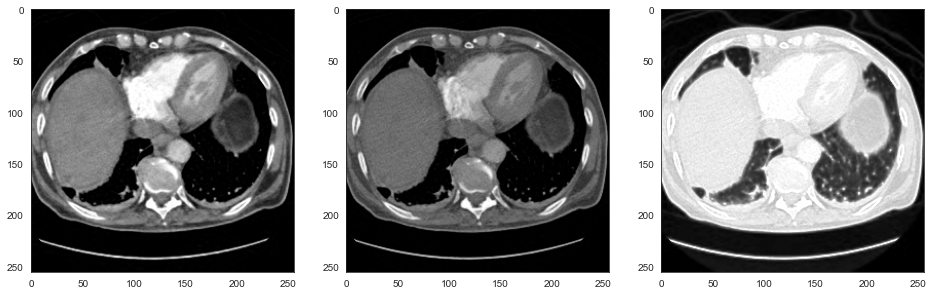

In [8]:
sns.set_style('white')
plt.figure(figsize=[16,8])
plt.subplot(131)
plt.imshow(img[:,:,0],cmap='gray')
plt.subplot(132)
plt.imshow(img[:,:,1],cmap='gray')
plt.subplot(133)
_ = plt.imshow(img[:,:,2],cmap='gray')

#### Create header photo for this notebook...

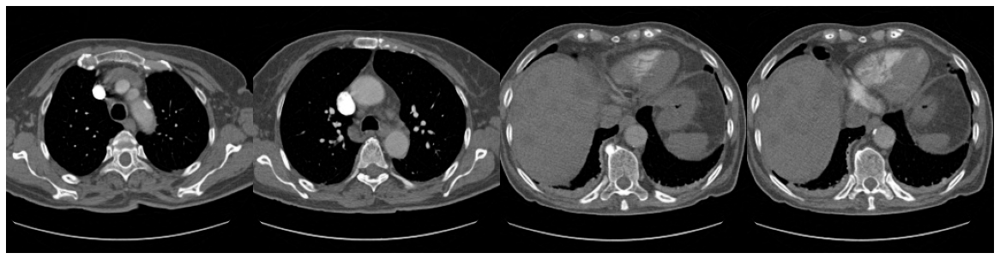

In [9]:
plt.figure(figsize=[16,8])
for x in range(0,4): 
    img = cv2.imread(np.random.choice(glob.glob(slice_pth)))
    plt.subplot(1,4,x+1)
    _ = plt.imshow(img[:,:,1],cmap='gray')
    plt.axis('off')
    plt.tight_layout(pad=0)
plt.savefig('../Data/CT Medical Images/images/header_pic.jpg', bbox_inches='tight')

**Lets dive into these images a little more and mess around with the `window()` function defined earlier.**

We will look at how this function changes which materials are more visible to the eye.

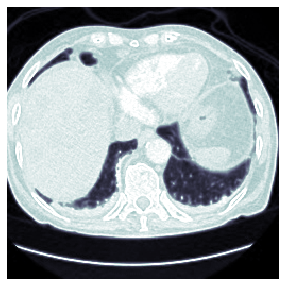

In [10]:
# first lets plot the image that we will be manipulating
plt.figure(figsize=(5,5))
plt.imshow(img[:,:,2], cmap='bone', interpolation='nearest')
_ = plt.axis('off')

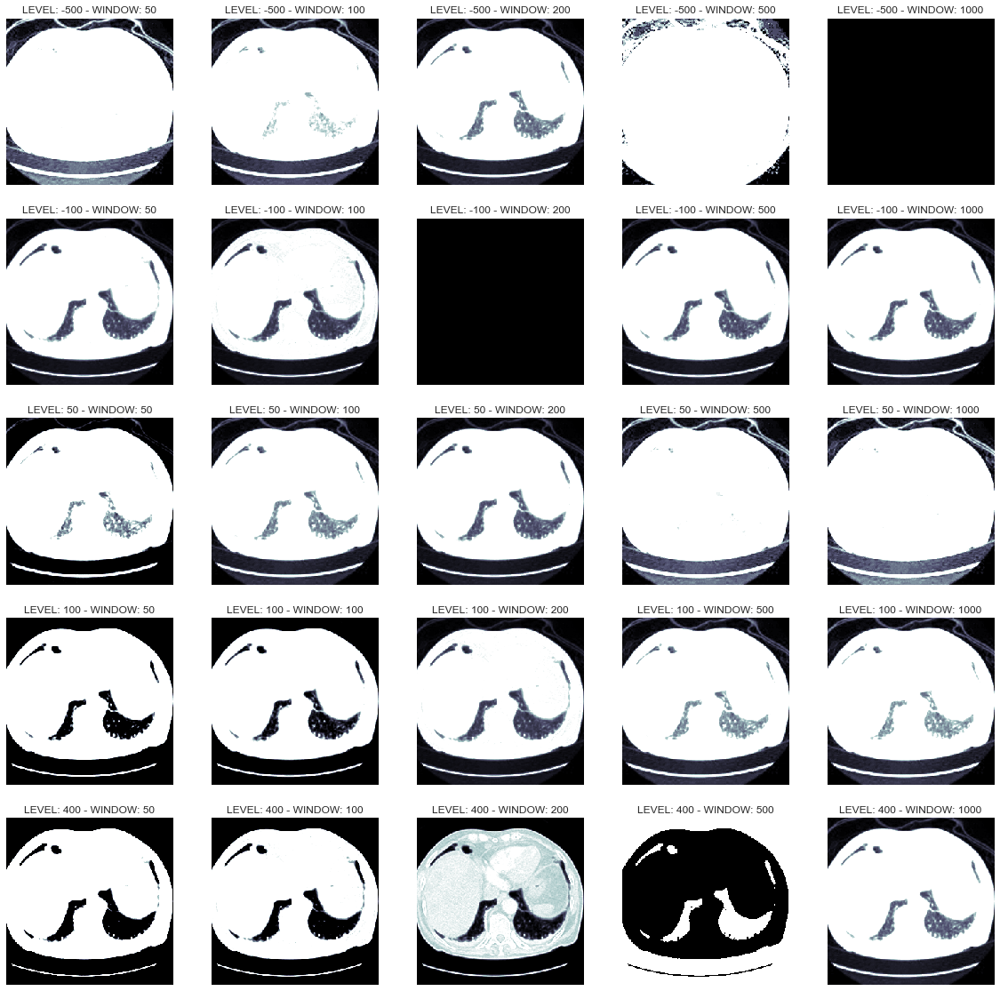

In [11]:
# now lets plot the same image, but through a different window
fig, axes = plt.subplots(5, 5, figsize=(20,20))

for r,l in enumerate([-500,-100,50,100,400]):
    for c,w in enumerate([50,100,200,500,1000]):
        win = window(img[:,:,2], WL=l, WW=w)
        axes[r,c].imshow(win, cmap='bone', interpolation='nearest')
        axes[r,c].set_title(F'LEVEL: {l} - WINDOW: {w}')
        axes[r,c].axis('off')
fig.savefig('../Data/CT Medical Images/images/windowed_lungs.jpg', bbox_inches='tight')

The original image was originally created using a *lung* window.

As we can see, the different window values really can distort the images apperance. Even though a lot of these pictures are not valuable to us, we can see how, in some cases, the lung membranes get emphasized more than the original image. We can use this to our advantage by using these parameters to create more accurate 3D reconstructions. It can also potentially help us identify pulmonary embolisms more efficiently.

**Next, we will look over a single patients study using the `create_gif()` function.**

In [12]:
# previously we created a slice path for the patients files, which I will display
slice_pth

'../Data/CT Medical Images/train-jpegs/6897fa9de148/2bfbb7fd2e8b/*.jpg'

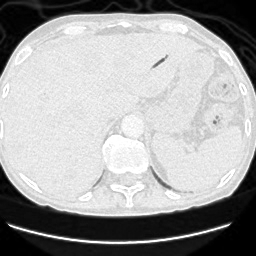

In [39]:
# now we will create a gif using this file path
img_pth = '../Data/CT Medical Images/images/gifs/gif_1.gif'
create_gif(slice_pth, save_img=img_pth)

In [14]:
# now we will create a scans list of all the JPG files in the patients folder
scans = glob.glob(slice_pth)

We will create pixel arrays using the `pixel_array()` function to build a more detailed gif.

In [15]:
# create pixel arrays
lung_pix_arr = pixel_array(scans, channel=2)
pe_pix_arr = pixel_array(scans, channel=1)
med_pix_arr = pixel_array(scans, channel=0)

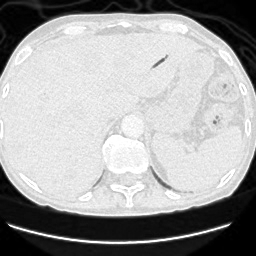

In [40]:
img_pth = '../Data/CT Medical Images/images/gifs/masked_lungs.gif'
create_gif(lung_pix_arr, save_img=img_pth, masked=True)

As we can see, the 'masked' parameter highlighted the lungs in the image. We will use this function to try and identify the PE in the patients chest.

To do this, we will need to identify the 'co_low' and 'co_high' parameter in the `create_gif()` function. We can find this out by plotting the pixel distribution.

To correlate this information to a pulmonary embolism, we are also going to have to find out the Hounsfield Unit values in the images. We will use the `transform_to_hu()` function to create new arrays.

We will then plot the 'pe_' prefixed arrays for pulmonary embolism identification...

In [17]:
pe_hu_arr = transform_to_hu(scans, key='PE')
lung_hu_arr = transform_to_hu(scans, 'lung')
med_hu_arr = transform_to_hu(scans, 'mediastinal')

Now we will plot the pixel arrays for the lungs...

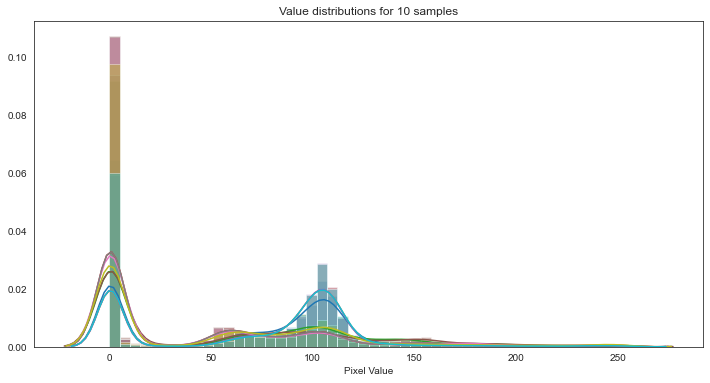

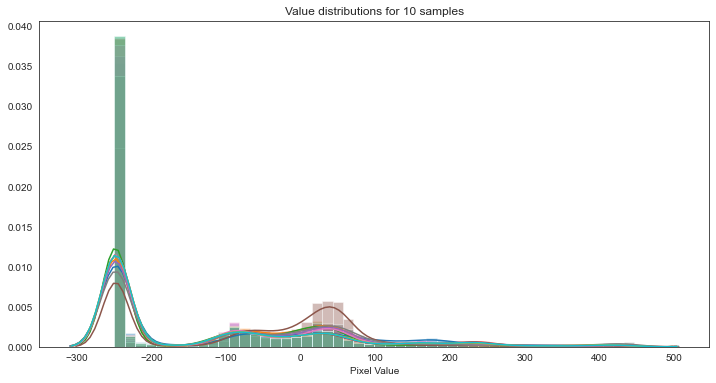

In [18]:
for item in [pe_pix_arr, pe_hu_arr]:
    plot_arr_vals(item, n_slices=10)

There are two types of pulmonary embolisms, acute and chronic. Due to this, there are two different HU value ranges that we will explore.

According to some cross referenced acedemic articles, the ranges are ***roughly*** as follows:

- Acute   : +18 to +48
- Chronic : +55 to +120

These are just some findings... The ranges can vary quite a bit, but this is what we will use for this search.

**Now coming back to the above plots, we will correlate these ranges to the RGB value ranges.** For acute, we will use a range of **100 to 115**. For chronic, we will use a range of **117 to 140**.

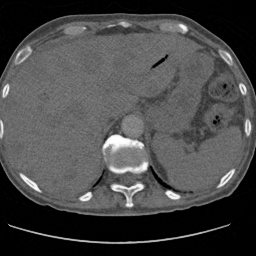

In [42]:
# acute PE detection attempt...
img_pth = '../Data/CT Medical Images/images/gifs/masked_pe_1.gif'
create_gif(pe_pix_arr, save_img=img_pth, masked=True, co_low=100, co_high=115)

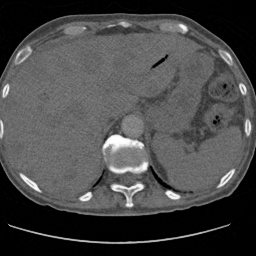

In [43]:
img_pth = '../Data/CT Medical Images/images/gifs/masked_pe_2.gif'
create_gif(pe_pix_arr, save_img=img_pth, masked=True, co_low=117, co_high=140)

Welp... Not very good results first time through.

Regardless of the lack of results, there does seem to be some spots that show up on the acute PE gif. What we do know is that there is a PE present in this patients lungs, but we aren't sure if it is the mask that is popping up in the gif...

Looks like we will have to do more research! Let's create a 3D reconstruction of the lungs quick.

# 3D Reconstruction

Let's start by creating a reconstruction of the chest. To do this, we will use the 'lung' channel.

In [21]:
plot_3d(lung_hu_arr)

C:\Users\samdo\Anaconda3\lib\site-packages\traittypes\traittypes.py:101: UserWarning: Given trait value dtype "int32" does not match required type "uint32". A coerced copy has been created.
  np.dtype(self.dtype).name))


Output()

In [49]:
IPython.display.Video('../Data/CT Medical Images/images/3d_plot_1.mp4', width=900)

Looking at the model above, we can see there is a lot of extra tissues. We want to only look at the lungs, so we will create a segmented version of this model using the `segment_mask()` fucntion.

## Image Segmentation

Let's look at the lung slices

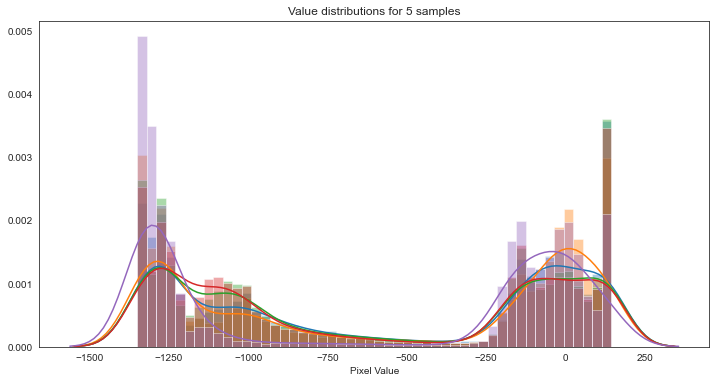

In [22]:
# first lets plot the HU values for the lungs
plot_arr_vals(lung_hu_arr)

Since lung tissues are around -600 HU, we are going to set the natural cutoff around -275. Looking at the above plot, the denser tissues start to come up around -250.

In [23]:
seg_lung = segment_mask(lung_hu_arr, co_low=-300)
plot_3d(seg_lung)

C:\Users\samdo\Anaconda3\lib\site-packages\traittypes\traittypes.py:101: UserWarning: Given trait value dtype "int32" does not match required type "uint32". A coerced copy has been created.
  np.dtype(self.dtype).name))


Output()

In [50]:
IPython.display.Video('../Data/CT Medical Images/images/3d_plot_2.mp4', width=900)

This is a decent reconstruction of the lungs, but we are going to use our previous knowledge from when we viewed the different windows, and we are going to *try* to create a more detailed lung reconstruction.

Lets review the previous subplots of the windowed images.

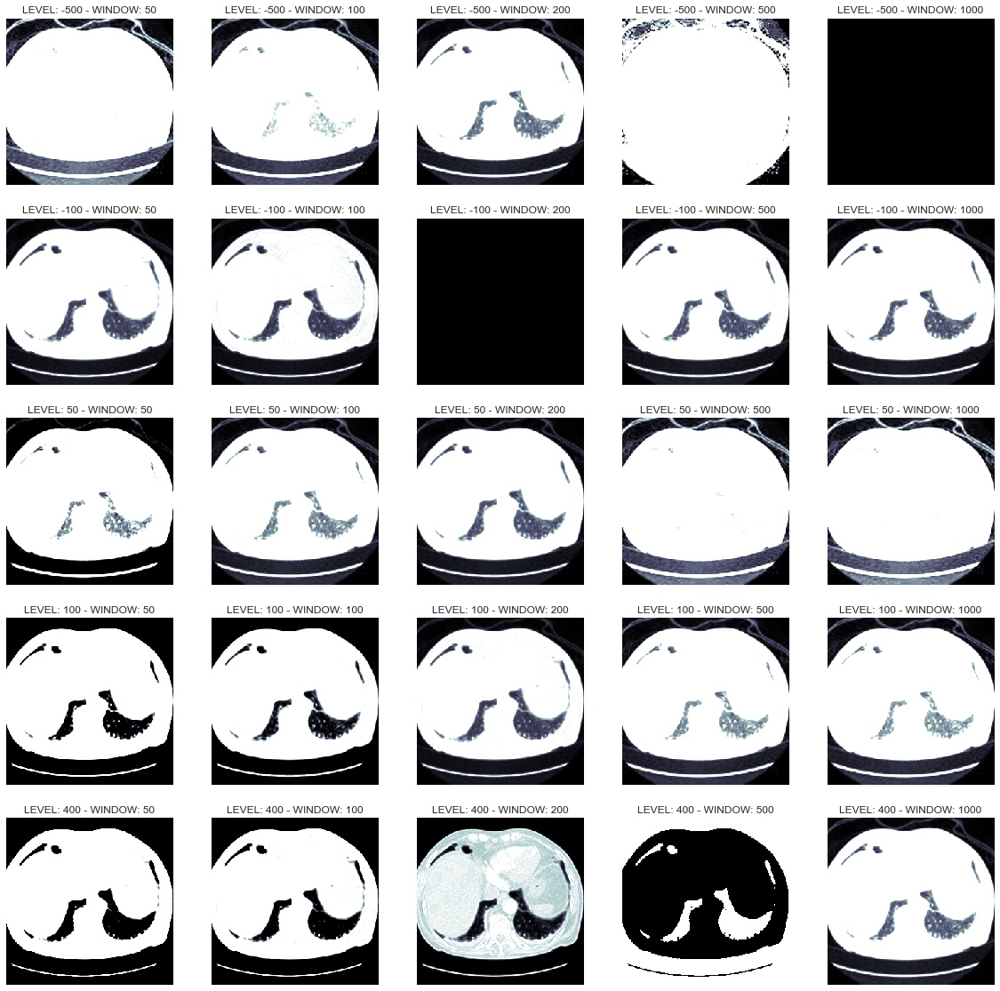

In [24]:
IPython.display.Image('../Data/CT Medical Images/images/windowed_lungs.jpg', width=750)

Looking at the above image, we are going to use the window parameters **LEVEL: -500, WINDOW: 200**.


We will build this off of the array `lung_hu_array`.

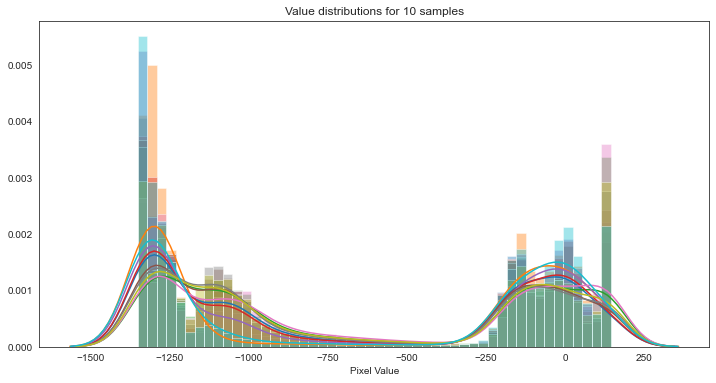

In [25]:
plot_arr_vals(lung_hu_arr, n_slices=10)

In [26]:
for n in range(lung_hu_arr.shape[2]):
    W = 255
    L = -700
    win = window(lung_hu_arr[:,:,n], WL=L, WW=W)
    
    # initialize array
    if n == 0:
        window_lung_arr = win
    else:
        window_lung_arr = np.dstack((window_lung_arr, win))
        
print(window_lung_arr.shape)

(256, 256, 124)


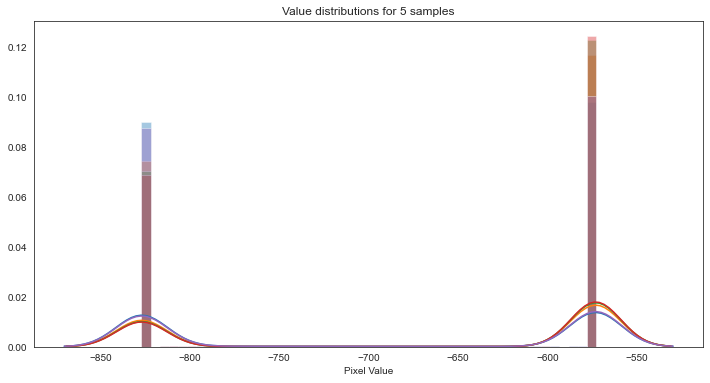

In [27]:
plot_arr_vals(window_lung_arr)

In [28]:
seg_win_lung = segment_mask(window_lung_arr, co_low=-800, co_high=None)
plot_3d(seg_win_lung, threshold=-100)

C:\Users\samdo\Anaconda3\lib\site-packages\traittypes\traittypes.py:101: UserWarning: Given trait value dtype "int32" does not match required type "uint32". A coerced copy has been created.
  np.dtype(self.dtype).name))


Output()

In [51]:
IPython.display.Video('../Data/CT Medical Images/images/3d_plot_3.mp4', width=900)

As we can see, the model is not nearly as smooth, but we can see more detail in the bronchioles.

**Just like we can segment out the lungs from the rest of the chest, lets try to group different parts of the chest to try and identify any anomaly - with intentions of finding the PE.**

To do this, we will use the `create_mesh_slices()` function.

In [32]:
segmented_slices = create_mesh_slices(lung_hu_arr, HU_val=30, l_count=800)

C:\Users\samdo\Anaconda3\lib\site-packages\ipykernel_launcher.py:302: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


Head of label dataframe.


,label,count
0,139378,369614
1,26,199918
2,2811225,179495
3,2776803,111264
4,2776831,109811



Starting to find HU values...

(10 / 106) values found...
(20 / 106) values found...
(30 / 106) values found...
(40 / 106) values found...
(50 / 106) values found...
(60 / 106) values found...
(70 / 106) values found...
(80 / 106) values found...
(90 / 106) values found...
(100 / 106) values found...
(106 / 106) values found...

Done finding HU values...

Dataframe head with HU values.


C:\Users\samdo\Anaconda3\lib\site-packages\ipykernel_launcher.py:347: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


,index,label,count,HU val
0,0,139378,369614,144
1,14,3192020,29333,144
2,16,1422436,23814,144
3,56,871987,1749,138
4,85,1104413,984,138


Creating image dictionary at index: 0
Creating image dictionary at index: 14
Creating image dictionary at index: 16
Creating image dictionary at index: 56
Creating image dictionary at index: 85

Finished creating image slices.


Now that we have our slice dictionary, we can create a 3D plot.

In [33]:
plot_3d(segmented_slices)

C:\Users\samdo\Anaconda3\lib\site-packages\traittypes\traittypes.py:101: UserWarning: Given trait value dtype "int32" does not match required type "uint32". A coerced copy has been created.
  np.dtype(self.dtype).name))


Output()

In [52]:
IPython.display.Video('../Data/CT Medical Images/images/3d_plot_4.mp4', width=900)

Although we were able to pull different tissues in the chest, not sure if they are very helpful to us at the moment.

This could use some work...

# THIS NOTEBOOK IS UNDER WORK...

References:

Shows HU values of pulmonary embolisms
https://pubmed.ncbi.nlm.nih.gov/15833986/#:~:text=Results%3A%20Reader%201%20found%20mean,for%20acute%20PE%20

---

## Now we want to try and identify the PE in the 3D image and the 2D images.
Try to change the color of the images for the gif where `pe_on_image` (something like that) column is 1.

We will try this with patient 1 study...

In [29]:
df_pe_p1 = df[(df.pe_present_on_image==1) & (df.SeriesInstanceUID==df.SeriesInstanceUID[0])]
df_pe_p1.head()

,StudyInstanceUID,SeriesInstanceUID,SOPInstanceUID,pe_present_on_image,negative_exam_for_pe,qa_motion,qa_contrast,flow_artifact,rv_lv_ratio_gte_1,rv_lv_ratio_lt_1,leftsided_pe,chronic_pe,true_filling_defect_not_pe,rightsided_pe,acute_and_chronic_pe,central_pe,indeterminate
63,6897fa9de148,2bfbb7fd2e8b,c1a5538bba20,1,0,0,0,0,0,1,1,0,0,1,0,0,0
64,6897fa9de148,2bfbb7fd2e8b,fd9db7e0cffe,1,0,0,0,0,0,1,1,0,0,1,0,0,0
65,6897fa9de148,2bfbb7fd2e8b,1f108fe8cae4,1,0,0,0,0,0,1,1,0,0,1,0,0,0
75,6897fa9de148,2bfbb7fd2e8b,2a6b4c0ef0e5,1,0,0,0,0,0,1,1,0,0,1,0,0,0
76,6897fa9de148,2bfbb7fd2e8b,21c2645ae16d,1,0,0,0,0,0,1,1,0,0,1,0,0,0


In [30]:
base_path = proj_path + 'train-jpegs/' + f'{df_pe_p1.StudyInstanceUID.iloc[0]}/{df_pe_p1.SeriesInstanceUID.iloc[0]}/'
base_path

'../Data/CT Medical Images/train-jpegs/6897fa9de148/2bfbb7fd2e8b/'

In [31]:
scans_pe_p1 = []
for i,file in enumerate(df_pe_p1.SOPInstanceUID):
    df_pe_p1.file_path.iloc[i] = glob.glob(base_path + f'*{file}.jpg')[0]
    scans_pe_p1.append(glob.glob(base_path + f'*{file}.jpg')[0])
    #df_pe_p1.file_path.iloc[] = base_path + f'00{ind+1}_{df_pe_p1.SOPInstanceUID[ind]}.jpg'

AttributeError: 'DataFrame' object has no attribute 'file_path'

In [ ]:
slices_pe_p1 = transform_to_hu(scans_pe_p1)

# To be continued ...

In [ ]:
plot_hu_vals(slices_pe_p1)